In [1]:
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
from scipy.stats import spearmanr, pearsonr, mannwhitneyu

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
# Scanpy settings
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

celltype = 'NK'
master_dir = '../'

scanpy==1.6.0 anndata==0.7.5 umap==0.4.6 numpy==1.19.4 scipy==1.5.4 pandas==1.1.4 scikit-learn==0.23.2 statsmodels==0.12.1 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [4]:
# Name of results file 
results_file_all_genes = master_dir + 'output/' + celltype + '-processed-analyzed.h5ad'
results_file_metab_genes = master_dir + 'output/' + celltype + '-processed-analyzed-metab.h5ad'

# Read in counts matrix
adata = sc.read_h5ad(master_dir + 'data/PBMC/fo8_thru_in8_GEX_for_NK.h5ad')

In [5]:
adata

AnnData object with n_obs × n_vars = 17608 × 21517
    obs: 'patient', 'ICU_status', 'IL6i_between_draws', 'no_IL6i', 'WHO_scale', 'Blood_draw_time', 'Sex', 'Age_at_baseline', 'Days_since_onset_of_symptoms', 'leiden'
    uns: 'leiden_colors'
    obsm: 'X_umap'

In [6]:
adata.var_names

Index(['MIR1302-2HG', 'AL627309.1', 'AL627309.3', 'AL669831.5', 'FAM87B',
       'LINC00115', 'FAM41C', 'AL645608.3', 'SAMD11', 'NOC2L',
       ...
       'AC011043.1', 'AL592183.1', 'AC007325.1', 'AC007325.4', 'AC007325.2',
       'AL354822.1', 'AC004556.1', 'AC233755.2', 'AC233755.1', 'AC240274.1'],
      dtype='object', length=21517)

In [7]:
sum(adata.var_names.str.startswith('MT-'))

13

# Preprocessing

The gene list used was determined by filtering the initial 8 samples for genes that were expressed in 3 or more cells (per sample), then after that, every sample was just filtered for cells that expressed 200+ genes with some manual filtering of mito%, number of raw counts and number of genes, (usually like 5-10% mito, 10k raw counts, 3k genes but it varied if majority of cells all had higher or lower counts). Then just concatenated all of the samples together, split into gene expression data and protein data. Then, took the gene expression data and normalized each cell to have a count of 1e6 and then did log1p.

<u>Thus, no need to do further filtering, normalization, or log transformation below.</u>

normalizing counts per cell
    finished (0:00:01)


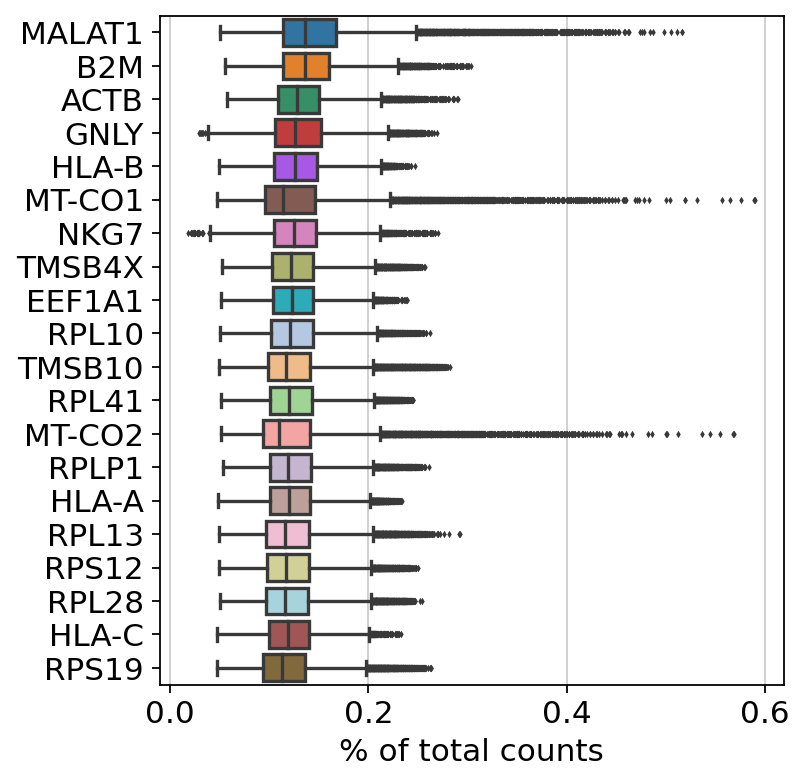

In [8]:
# Preprocessing
sc.pl.highest_expr_genes(adata, n_top=20)

# Clustering

In [9]:
# Loading in metabolics-relevant pathways from KEGG (based on Xiao et al. Nat Commun 2019)
#metab_pathway_list = pd.read_csv(master_dir + 'data/MSigDB/KEGG_metab_pathway_list_Xiao2019-JLmod200620.txt', 
#                                 sep='\t', header=None)
#metab_pathway_list = np.array(metab_pathway_list.iloc[:, 0])

# Genes in each KEGG pathway
metab_genes = pd.read_csv(master_dir + 'data/KEGG_genesets/hsa00001.metab.keg.gmt', 
                          sep='\t', header=None)
metab_genes.index = metab_genes.iloc[:, 0]
metab_genes = metab_genes.drop([0], axis=1)
#for geneset in metab_genes.index:
#    if metab_genes.loc[geneset, 1] not in metab_pathway_list:
#        metab_genes = metab_genes.drop(geneset, axis=0)
metab_pathway_list = metab_genes.index
metab_genes.head()

,1,2,3,4,5,6,7,8,9,10,...,124,125,126,127,128,129,130,131,132,133
0,,,,,,,,,,,,,,,,,,,,,
Glycolysis / Gluconeogenesis,LDHC,HK3,LDHB,PFKP,ALDOA,ALDOB,ADH6,GAPDHS,DLAT,PGM1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Citrate cycle (TCA cycle),DLST,ACO1,CS,IDH3B,ACLY,SUCLG2,DLAT,IDH3A,SUCLA2,PDHB,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pentose phosphate pathway,PFKP,ALDOA,RPIA,ALDOB,H6PD,RPE,RPEL1,PRPS1L1,PFKM,RBKS,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pentose and glucuronate interconversions,UGT2B4,UGT2A1,XYLB,CRYL1,UGT2B17,UGT1A3,UGDH,UGT1A4,UGT1A8,UGP2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Fructose and mannose metabolism,HK3,PFKFB3,PFKP,FCSK,ALDOA,ALDOB,GFUS,TPI1,PMM2,SORD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
# Pathways from Xiao et al. (2019) that are not found in the gene set list
set(metab_pathway_list).difference(set(metab_genes.index))

set()

In [11]:
# Get a flat array of metabolism-related genes
metab_gene_list = np.array(metab_genes.iloc[:, 1:]).flatten().astype(str)
metab_gene_list = metab_gene_list[metab_gene_list != 'nan']
len(metab_gene_list)

2841

In [12]:
# Make a new data object with only the metabolic genes from the KEGG pathways
metab_gene_list_overlap = list(set(metab_gene_list).intersection(set(adata.var_names)))
adata_metab = adata[:, metab_gene_list_overlap]
len(metab_gene_list_overlap)

1387

In [13]:
# Convert the metabolic pathways dataframe into a dictionary for GSEA
metab_genes_dict = metab_genes.transpose().to_dict(orient='series')
for element in metab_genes_dict:
    # Only include the genes that are also found in the single cell sequencing
    metab_genes_dict[element] = list(set(metab_genes_dict[element]).intersection(set(adata.var_names)))
    #metab_genes_dict[element] = metab_genes_dict[element][metab_genes_dict[element] != 'nan']
#metab_genes_dict['Glycolysis / Glucogeneogenesis_test'] = ['ACSS1', 'GAPDH']

## First, an analysis with all of the filtered genes (not just metabolic)

In [14]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    with n_comps=50
    finished (0:00:16)


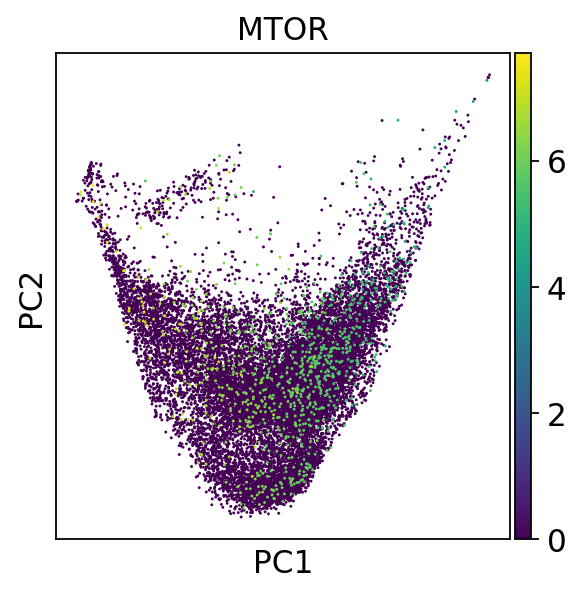

In [15]:
fig = sc.pl.pca(adata, color='MTOR')

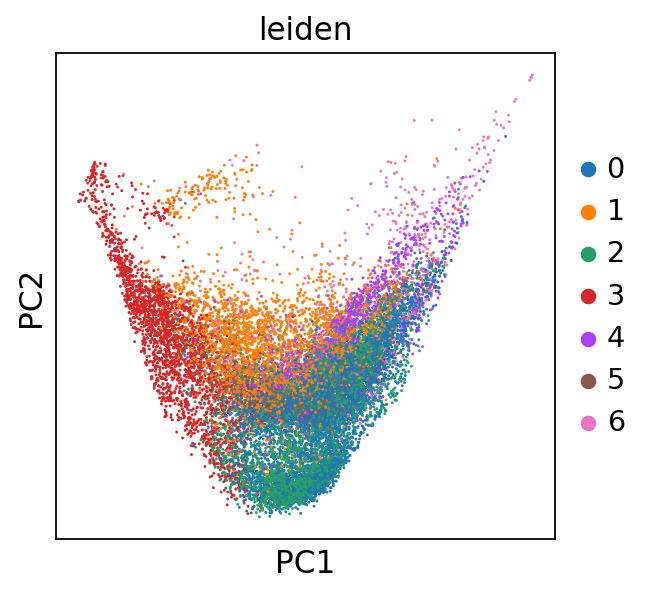

In [16]:
fig = sc.pl.pca(adata, color='leiden')

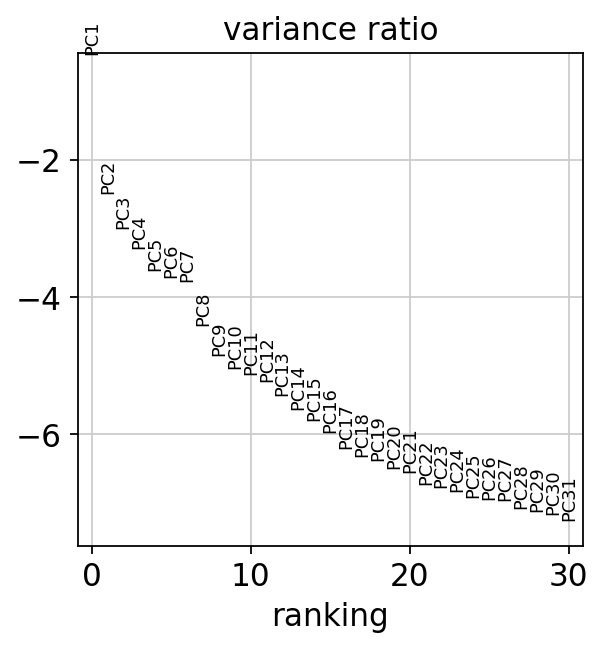

In [17]:
sc.pl.pca_variance_ratio(adata, log=True)

In [18]:
sc.pp.neighbors(adata)
#sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)


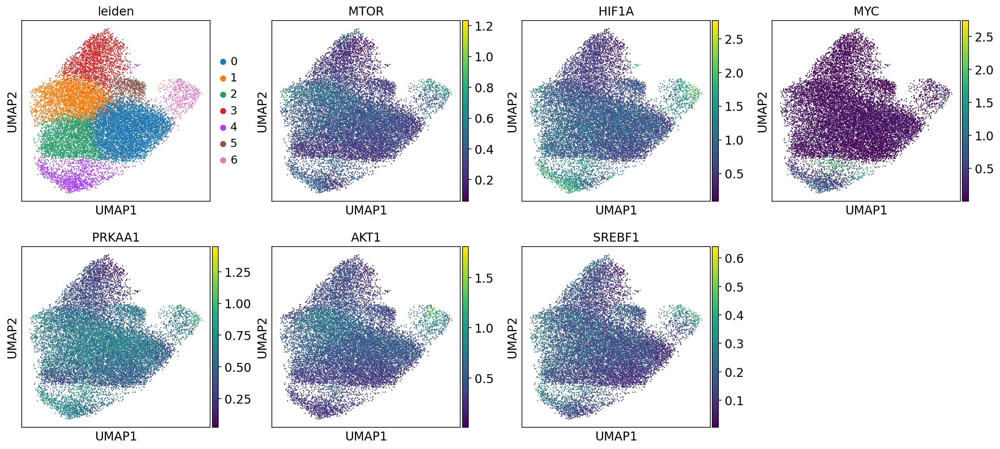

In [37]:
#fig = sc.pl.umap(adata, color=['louvain', 'MTOR', 'HIF1A', 'MYC', 
#                               'AKT1', 'ESRRA', 'RHOA', 'SREBF1',
#                              'ICOS', 'BCL6', 'PPARGC1A', 'IRF4', 'PRKAA1'], use_raw=False)
fig = sc.pl.umap(adata, color=['leiden', 'MTOR', 'HIF1A', 'MYC', 'PRKAA1', 'AKT1', 'SREBF1'], 
                 use_raw=False)

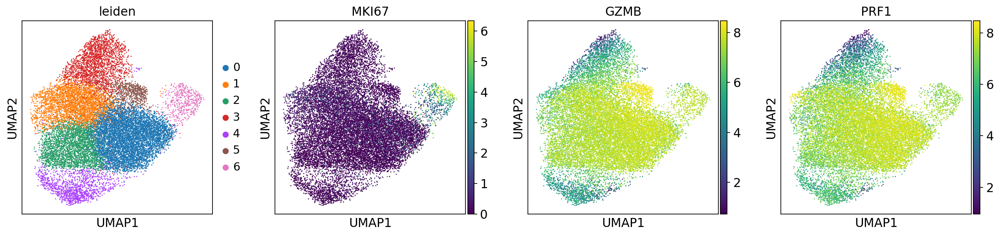

In [49]:
#fig = sc.pl.umap(adata, color=['louvain', 'MTOR', 'HIF1A', 'MYC', 
#                               'AKT1', 'ESRRA', 'RHOA', 'SREBF1',
#                              'ICOS', 'BCL6', 'PPARGC1A', 'IRF4', 'PRKAA1'], use_raw=False)
fig = sc.pl.umap(adata, color=['leiden', 'MKI67', 'GZMB', 'PRF1'], use_raw=False)

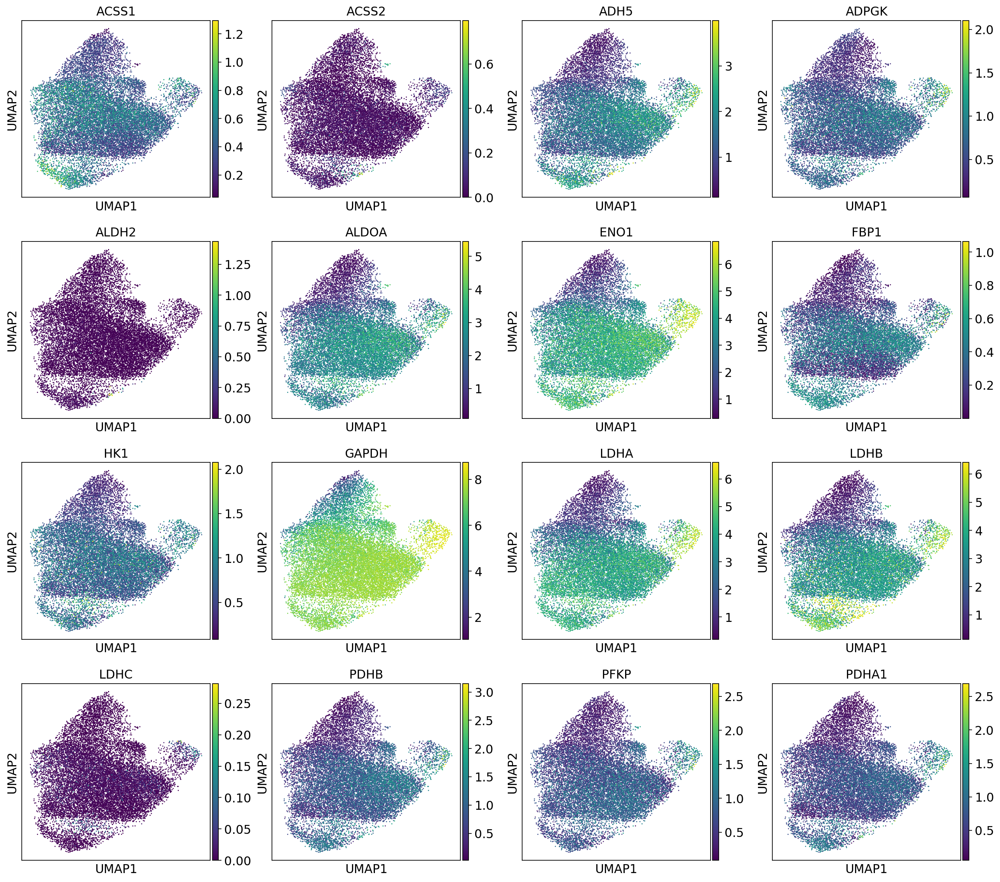

In [21]:
fig = sc.pl.umap(adata, color=['ACSS1', 'ACSS2', 'ADH5', 'ADPGK', 'ALDH2', 'ALDOA', 'ENO1', 
                               'FBP1', 'HK1', 'GAPDH', 'LDHA', 'LDHB', 'LDHC', 
                              'PDHB', 'PFKP', 'PDHA1'], cmap='viridis', use_raw=False)
# CD98 (SLC3A2) found in cells with high glycolytic activity
# GLUT1 (SLC2A1) upregulates glycolysis
# 4-1BB (TNFRSF9) upregulates FAO and glycolysis
# DNM1L induces mitochondrial fragmentation in effector cells

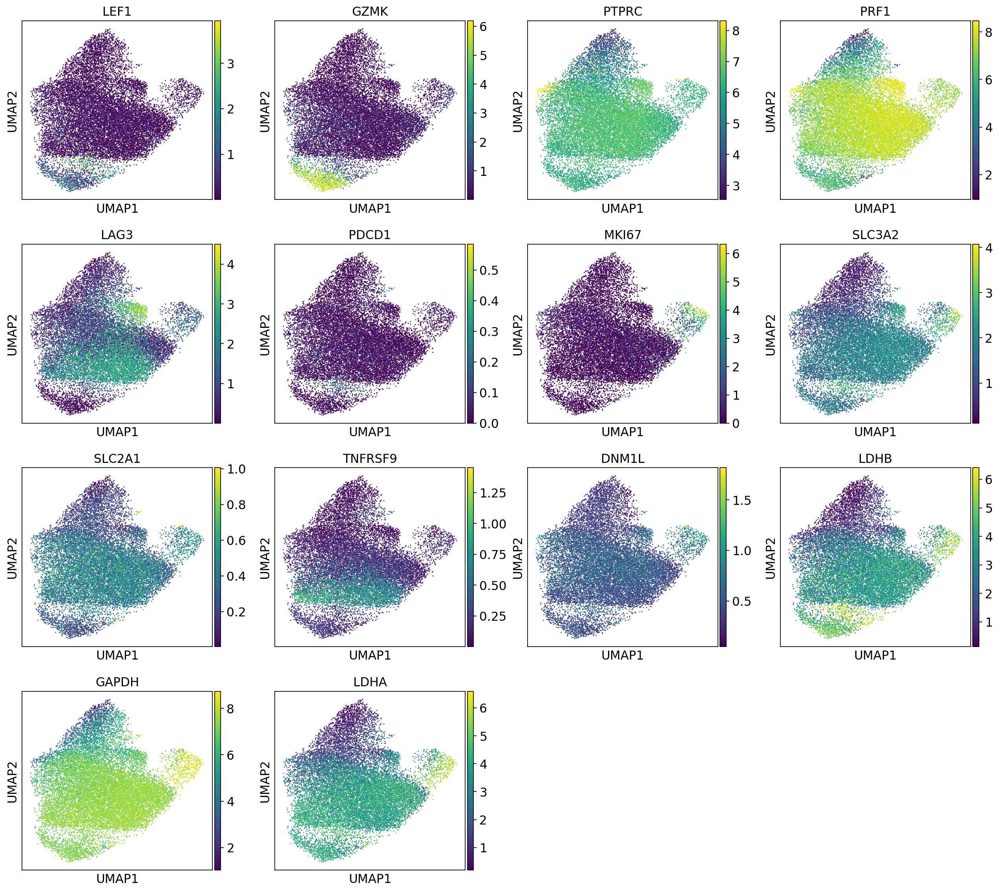

In [20]:
fig = sc.pl.umap(adata, color=['LEF1', 'GZMK', 'PTPRC', 'PRF1', 'LAG3', 'PDCD1', 'MKI67', 
                               'SLC3A2', 'SLC2A1', 'TNFRSF9', 'DNM1L', 'LDHB', 'GAPDH', 
                              'LDHA'], cmap='viridis', use_raw=False)
# CD98 (SLC3A2) found in cells with high glycolytic activity
# GLUT1 (SLC2A1) upregulates glycolysis
# 4-1BB (TNFRSF9) upregulates FAO and glycolysis
# DNM1L induces mitochondrial fragmentation in effector cells

In [22]:
adata.obs['Days_since_onset_float'] = adata.obs['Days_since_onset_of_symptoms'].apply(lambda x:float(x) if x!= 'Healthy' else -1).astype(float)

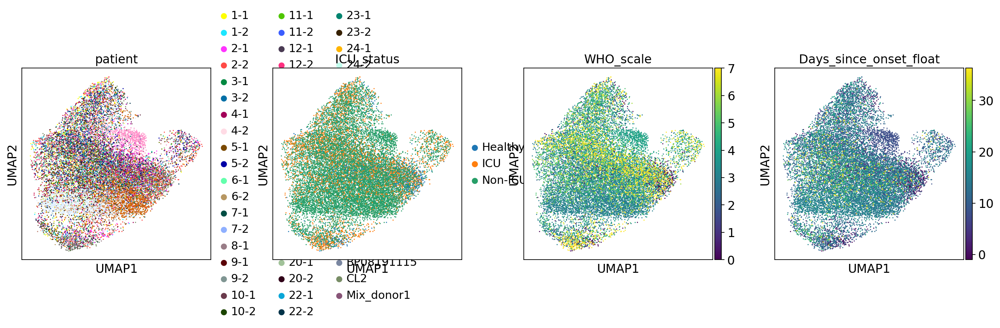

In [23]:
fig = sc.pl.umap(adata, color=['patient', 'ICU_status', 'WHO_scale', 'Days_since_onset_float'], use_raw=False)

In [24]:
sc.tl.embedding_density(adata, basis='umap', groupby='ICU_status')

computing density on 'umap'
--> added
    'umap_density_ICU_status', densities (adata.obs)
    'umap_density_ICU_status_params', parameter (adata.uns)


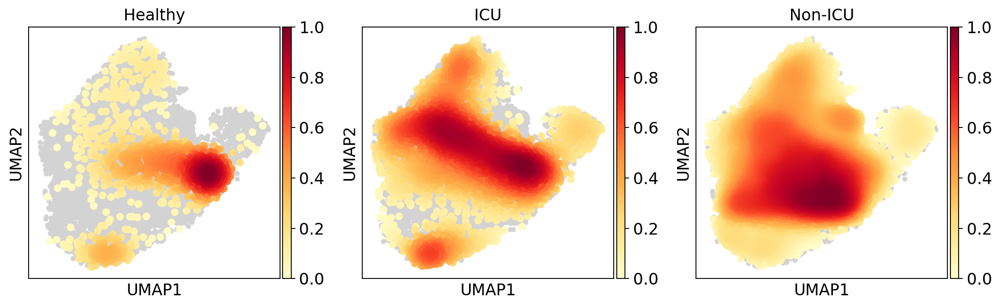

In [25]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_ICU_status')

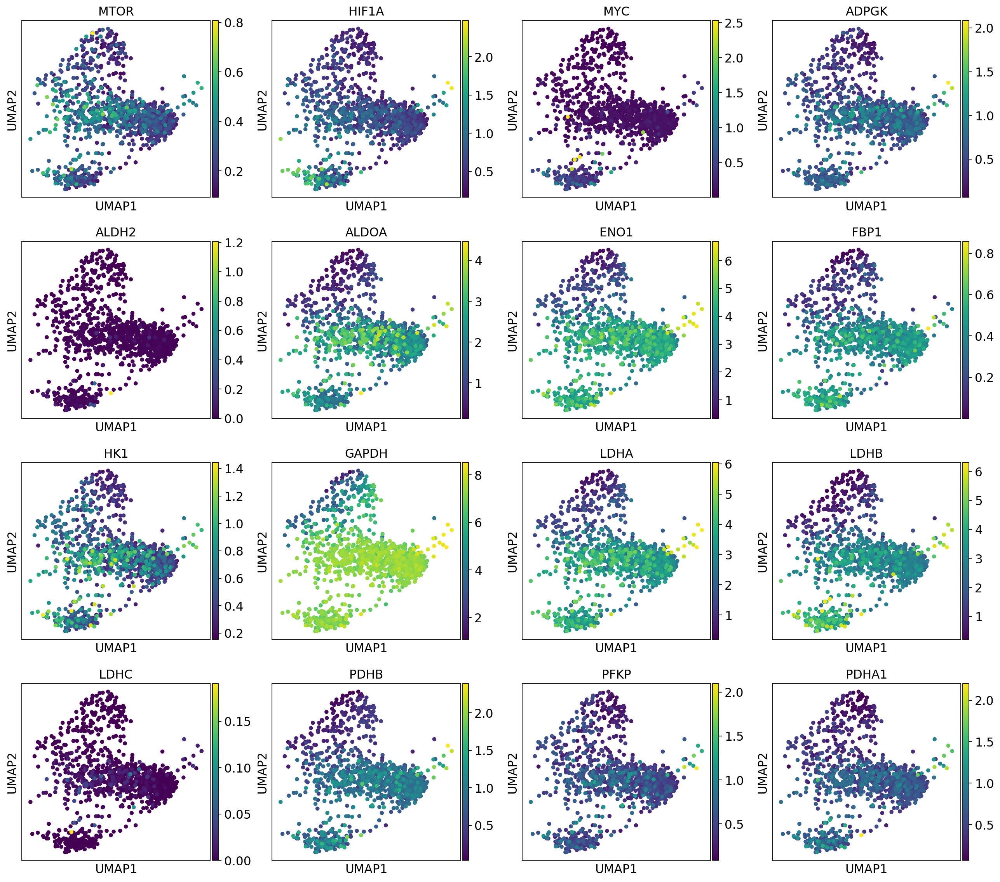

In [26]:
# Show only cells from healthy samples
adata_healthy = adata[adata.obs['WHO_scale']==0]
fig = sc.pl.umap(adata_healthy, color=['MTOR', 'HIF1A', 'MYC', 'ADPGK', 'ALDH2', 'ALDOA', 'ENO1', 
                               'FBP1', 'HK1', 'GAPDH', 'LDHA', 'LDHB', 'LDHC', 
                              'PDHB', 'PFKP', 'PDHA1'], cmap='viridis', use_raw=False)

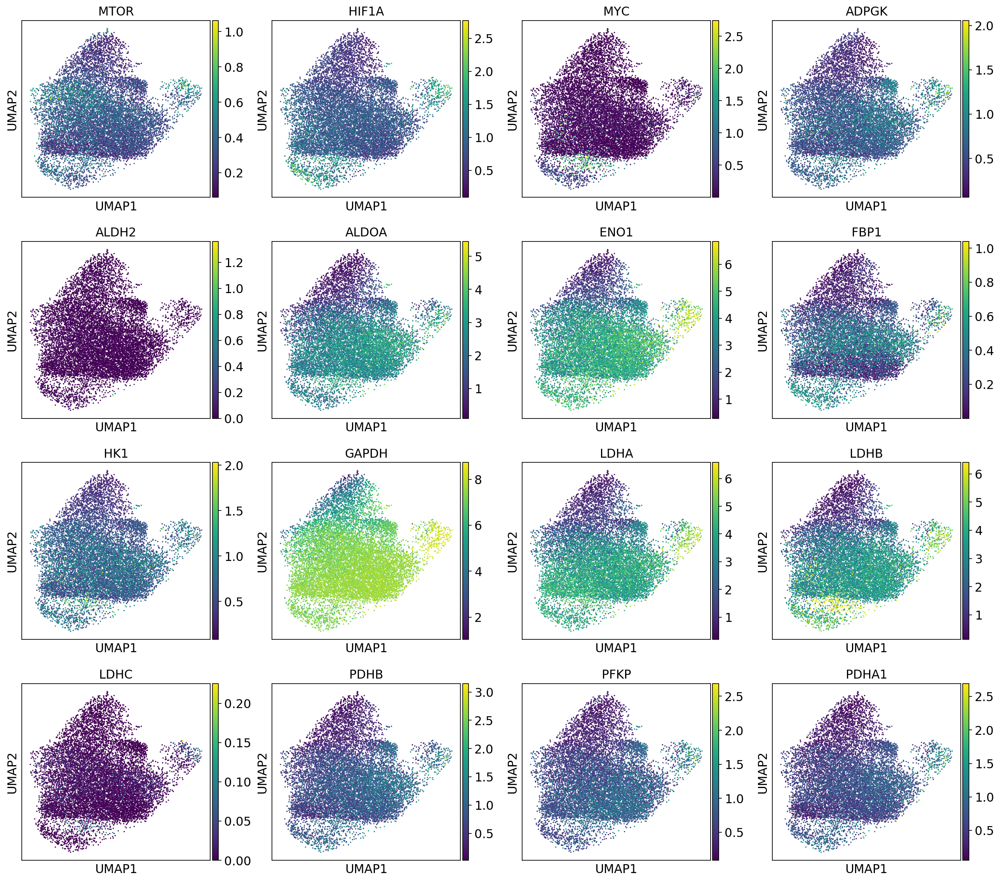

In [27]:
# Show only cells from sick samples
adata_nonICU = adata[adata.obs['ICU_status']=='Non-ICU']
fig = sc.pl.umap(adata_nonICU, color=['MTOR', 'HIF1A', 'MYC', 'ADPGK', 'ALDH2', 'ALDOA', 'ENO1', 
                               'FBP1', 'HK1', 'GAPDH', 'LDHA', 'LDHB', 'LDHC', 
                              'PDHB', 'PFKP', 'PDHA1'], cmap='viridis', use_raw=False)

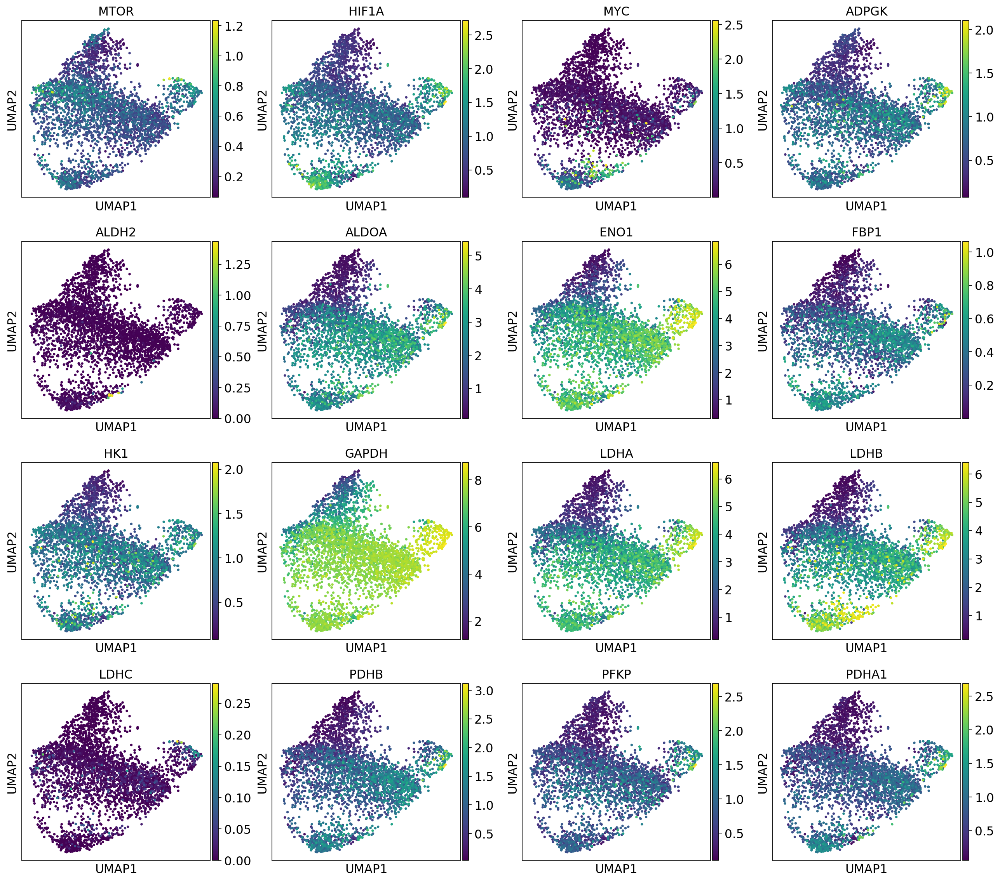

In [28]:
# Show only cells from sick samples
adata_ICU = adata[adata.obs['ICU_status']=='ICU']
fig = sc.pl.umap(adata_ICU, color=['MTOR', 'HIF1A', 'MYC', 'ADPGK', 'ALDH2', 'ALDOA', 'ENO1', 
                               'FBP1', 'HK1', 'GAPDH', 'LDHA', 'LDHB', 'LDHC', 
                              'PDHB', 'PFKP', 'PDHA1'], cmap='viridis', use_raw=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:01:04)


/usr/lusers/jlee712/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


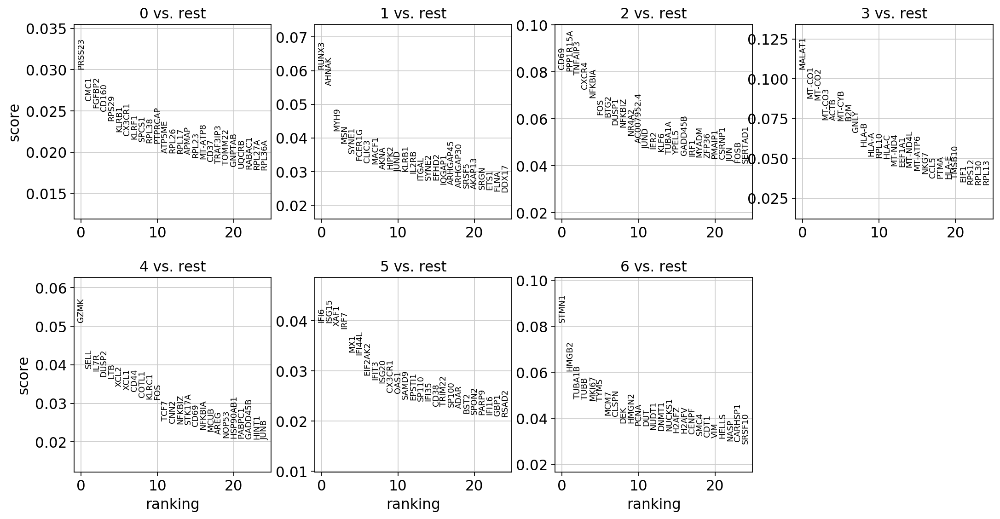

In [29]:
# Finding top genes per leiden cluster
sc.tl.rank_genes_groups(adata, 'leiden', method='logreg', use_raw=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [30]:
# Show the above ranked genes in table format
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6
0,PRSS23,RUNX3,CD69,MALAT1,GZMK,IFI6,STMN1
1,CMC1,AHNAK,PPP1R15A,MT-CO1,SELL,ISG15,HMGB2
2,FGFBP2,MYH9,TNFAIP3,MT-CO2,IL7R,XAF1,TUBA1B
3,CD160,MSN,CXCR4,MT-CO3,DUSP2,IRF7,TUBB
4,RPS29,SYNE1,NFKBIA,ACTB,LTB,MX1,MKI67


## Now, an analysis with metabolic pathway genes only
The anndata object for this was created above already.

In [31]:
sc.tl.pca(adata_metab, svd_solver='arpack')

computing PCA
    with n_comps=50
    finished (0:00:01)


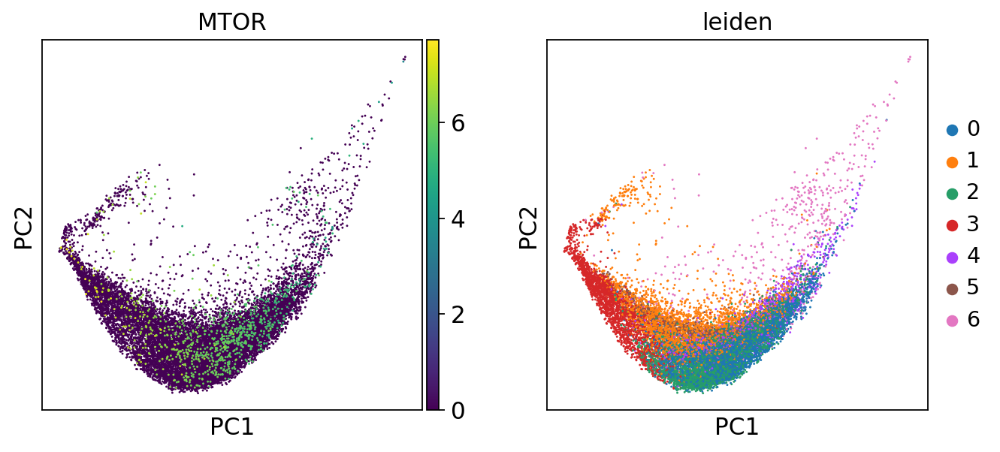

In [32]:
# Before running the next cell, this 'louvain' coloring will be by overall cluster
fig = sc.pl.pca(adata_metab, color=['MTOR', 'leiden'])#, title='CD4+ cells clustered by all genes')

In [33]:
sc.pp.neighbors(adata_metab)
sc.tl.umap(adata_metab)
sc.tl.louvain(adata_metab, resolution=0.1)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 6 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:01)


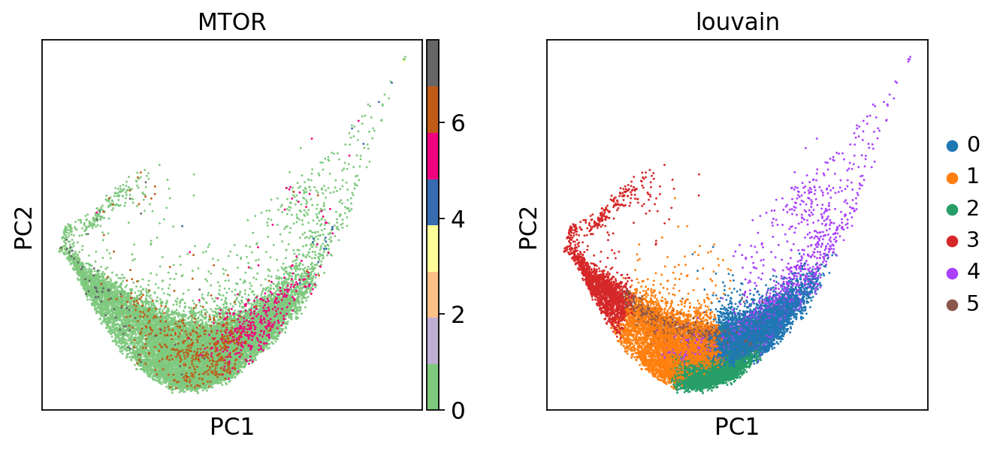

In [34]:
fig = sc.pl.pca(adata_metab, color=['MTOR', 'louvain'], cmap='Accent')#, title='CD4+ cells clustered by all genes')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:04)


/usr/lusers/jlee712/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


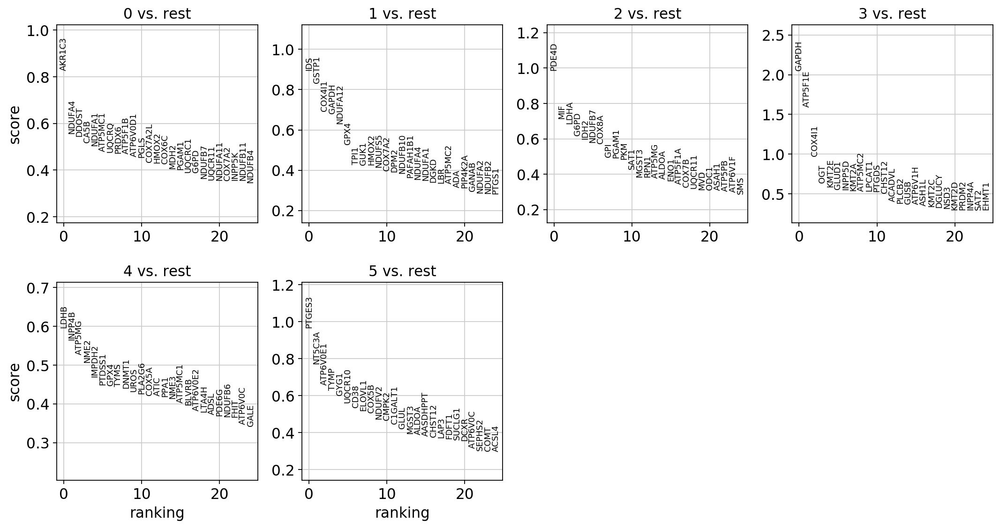

In [35]:
# Finding top genes per leiden cluster
sc.tl.rank_genes_groups(adata_metab, 'louvain', method='logreg', use_raw=False)
sc.pl.rank_genes_groups(adata_metab, n_genes=25, sharey=False)

In [36]:
# Show the above ranked genes in table format
pd.DataFrame(adata_metab.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5
0,AKR1C3,IDS,PDE4D,GAPDH,LDHB,PTGES3
1,NDUFA4,GSTP1,MIF,ATP5F1E,INPP4B,NT5C3A
2,DDOST,COX4I1,LDHA,COX4I1,ATP5MG,ATP6V0E1
3,CA5B,GAPDH,G6PD,OGT,NME2,TYMP
4,NDUFA1,NDUFA12,IDH2,KMT2E,IMPDH2,GYG1


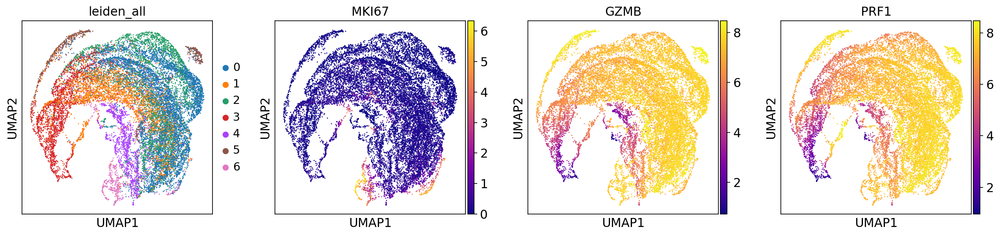

In [23]:
adata_metab_all_genes = adata.copy()
adata_metab_all_genes.obs = adata_metab.obs.copy()
adata_metab_all_genes.uns = adata_metab.uns.copy()
adata_metab_all_genes.obsm = adata_metab.obsm.copy()
fig = sc.pl.umap(adata_metab_all_genes, color=['leiden_all', 'MKI67', 'GZMB', 'PRF1'], 
                 cmap='plasma', use_raw=False)

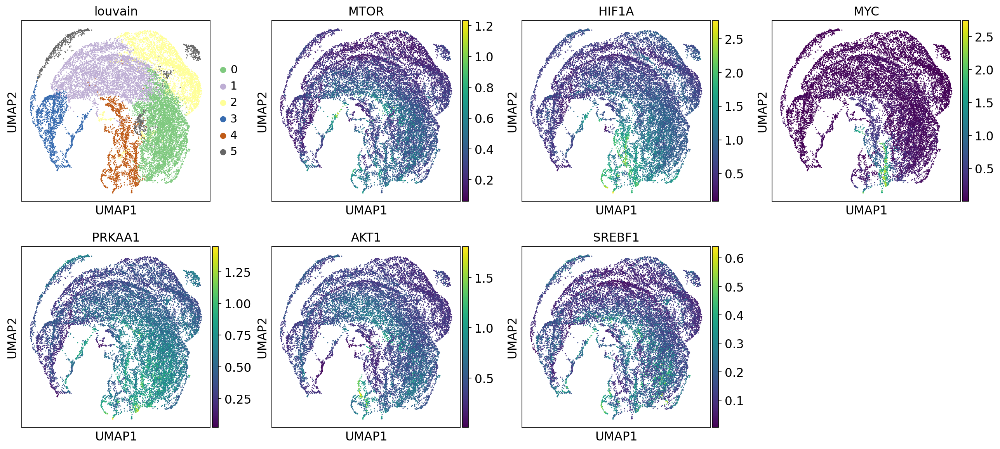

In [38]:
fig = sc.pl.umap(adata_metab_all_genes, color=['louvain', 'MTOR', 'HIF1A', 'MYC', 'PRKAA1', 'AKT1', 'SREBF1'], 
                 use_raw=False)

In [39]:
adata_metab.obs['Days_since_onset_float'] = adata_metab.obs['Days_since_onset_of_symptoms'].apply(lambda x:float(x) if x!= 'Healthy' else -1).astype(float)

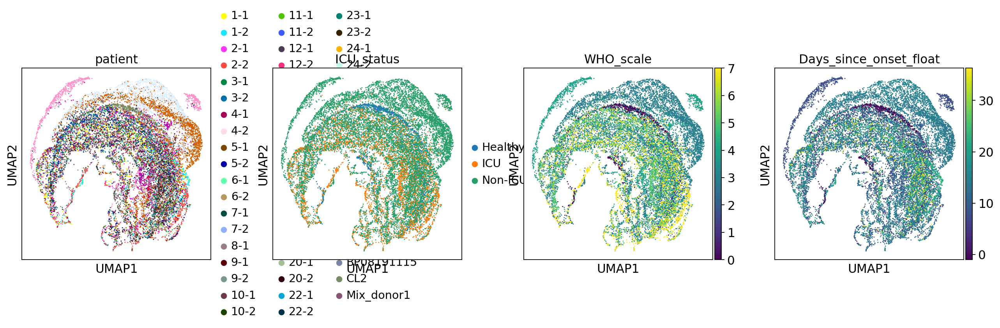

In [40]:
fig = sc.pl.umap(adata_metab, color=['patient', 'ICU_status', 'WHO_scale', 'Days_since_onset_float'], use_raw=False)

... storing 'severity' as categorical


computing density on 'umap'
--> added
    'umap_density_severity', densities (adata.obs)
    'umap_density_severity_params', parameter (adata.uns)


/home/jwlee/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/__init__.py:1156: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("YlOrRd"))
  color_map.set_over('black')
/home/jwlee/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/__init__.py:1157: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("YlOrRd"))
  color_map.set_under('lightgray')
/home/jwlee/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecat

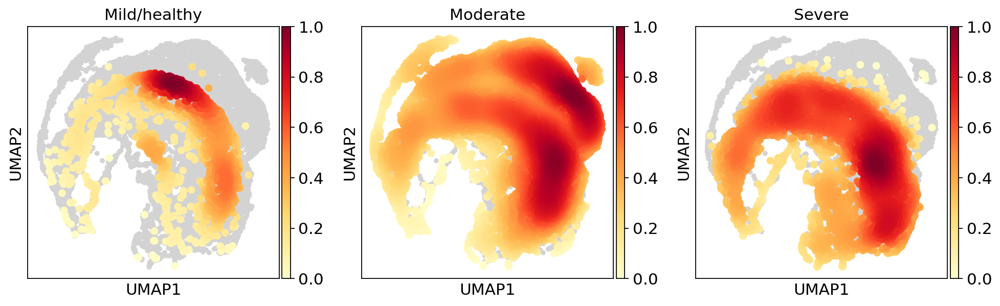

In [18]:
# New in revision
adata.obs['severity'] = ['Severe' if x > 4 else 'Moderate' if x > 2 else 'Mild/healthy' 
                         for x in adata.obs['WHO_scale']]
adata_metab.obs['severity'] = adata.obs['severity']
sc.tl.embedding_density(adata_metab, basis='umap', groupby='severity')
sc.pl.embedding_density(adata_metab, basis='umap', key='umap_density_severity', 
                        group=['Mild/healthy', 'Moderate', 'Severe'])

# Saving data
1. Metabolic gene list
2. Cluster data with all genes
3. Cluster data with metabolic genes

In [42]:
# This was already saved from the file 'CD4-clustering.ipynb'
# Metabolic gene list
#metab_gene_file = open(master_dir + 'output/hsa0001.metab-genes.txt', 'w')
#for gene in metab_gene_list:
#    metab_gene_file.write(gene + '\n')
#metab_gene_file.close()

In [43]:
# Cluster data with all genes
#adata.write(results_file_all_genes)

In [44]:
# Cluster data with metabolic genes
#adata_metab.write(results_file_metab_genes)

# More analysis
6/28/20


In [14]:
# Read in the processed counts matrix
adata = sc.read_h5ad(results_file_all_genes)
adata_metab = sc.read_h5ad(results_file_metab_genes)

In [15]:
adata

AnnData object with n_obs × n_vars = 17608 × 21517
    obs: 'patient', 'ICU_status', 'IL6i_between_draws', 'no_IL6i', 'WHO_scale', 'Blood_draw_time', 'Sex', 'Age_at_baseline', 'Days_since_onset_of_symptoms', 'leiden', 'Days_since_onset_float', 'umap_density_ICU_status'
    uns: 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap_density_ICU_status_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [16]:
adata_metab.obs['leiden_all'] = adata.obs['leiden']

In [17]:
adata.obs['louvain_metab'] = adata_metab.obs['louvain']

In [18]:
# Function for stacked bar plots to compare metabolic and all-gene clusters
def plot_bar(adata, x, y, df, kind, out, ax=None, stacked=True, colors=None, \
    rotation=0, xorder=None, yorder=None, cmap=None, **kwargs):

    if kind=='Frequency':
        props = df.groupby(x)[y].value_counts(normalize=True).unstack()
    elif kind=='Count':
        props = df.groupby(x)[y].value_counts(normalize=False).unstack()

    if xorder is not None:
        props = props.loc[xorder]
    if yorder is not None:
        props = props.loc[:, yorder]
    # stacked barplot
    with sns.axes_style('ticks'):
        if cmap is not None:
            colors = [cmap[col] for col in props.columns]
        elif y+'_colors' in adata.uns:
            palette = adata.uns[y+'_colors']
            categories = adata.obs[y].cat.categories
            cmap = {cat:color for cat, color in zip(categories, palette)}
            colors = [cmap[cat] for cat in props.columns]
        if stacked:
            ax = props.plot(kind='bar', stacked='True', color=colors, ax=ax, **kwargs)
        else:
            ax = props.plot(kind='bar', stacked=None, color=colors, ax=ax, **kwargs)
        ax.legend(bbox_to_anchor=(1.2,0.8))
        sns.despine()
        ax.set_ylabel(kind)
        ax.set_xlabel(x)
        ax.tick_params(axis='x', which='major', labelrotation=rotation)
        fig = ax.get_figure()
        fig.savefig('{}/{}_{}_{}{}.pdf'.format(out, x,y,kind, '_stacked'*stacked), \
            bbox_inches='tight', transparent=True)
        plt.close()
    return 

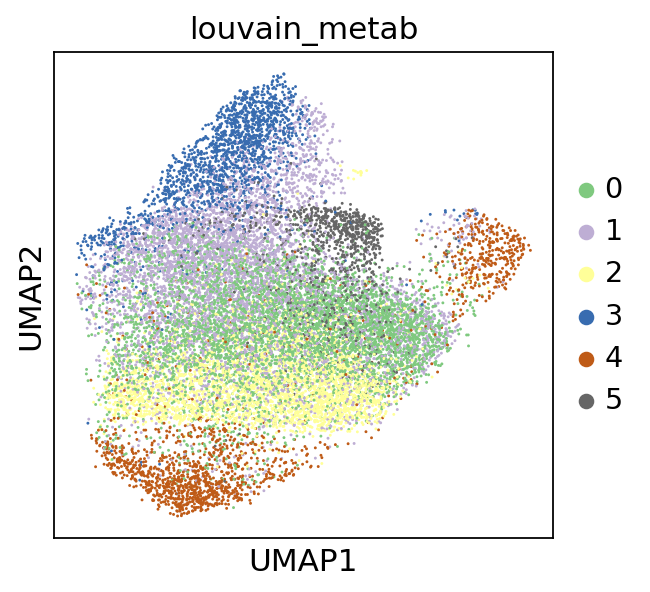

In [19]:
sc.pl.umap(adata, color='louvain_metab', palette='Accent')

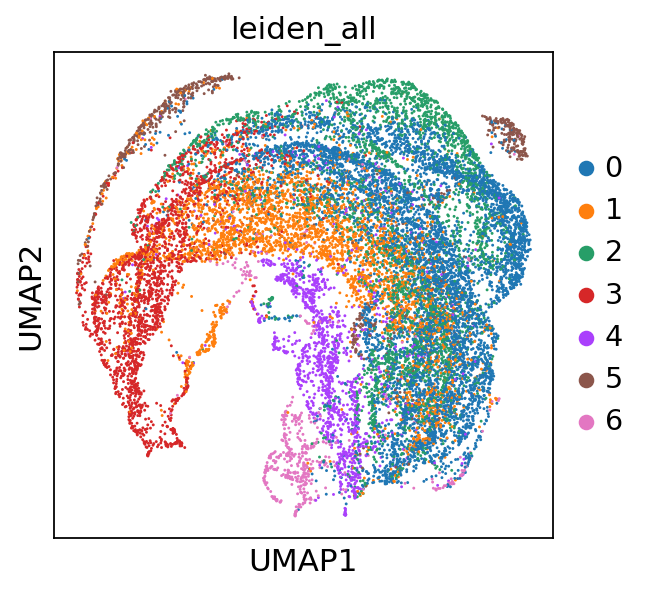

In [20]:
fig = sc.pl.umap(adata_metab, color=['leiden_all'], use_raw=False)

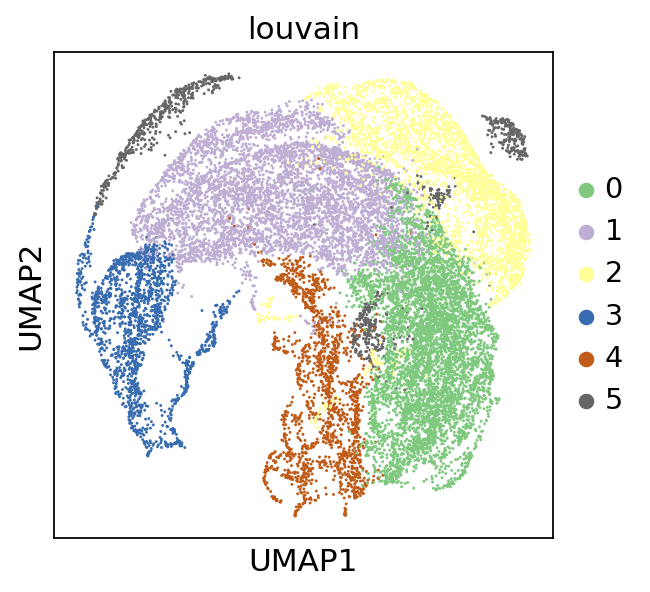

In [21]:
sc.pl.umap(adata_metab, color='louvain', palette='Accent')

... storing 'prolif_noProlif' as categorical


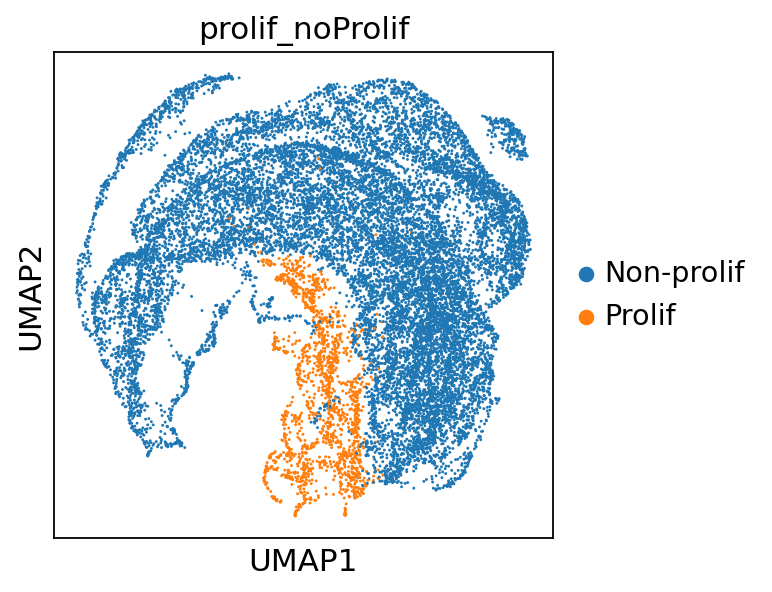

In [22]:
adata_metab.obs['prolif_noProlif'] = adata_metab.obs['louvain'].apply(lambda x: 'Prolif' if x=='4' else 'Non-prolif')
adata.obs['prolif_noProlif'] = adata.obs['louvain_metab'].apply(lambda x: 'Prolif' if x=='4' else 'Non-prolif')
sc.pl.umap(adata_metab, color='prolif_noProlif')

In [54]:
plot_bar(adata, 'leiden', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [55]:
plot_bar(adata, 'WHO_scale', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [56]:
plot_bar(adata, 'ICU_status', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters',
         xorder=['Healthy', 'Non-ICU', 'ICU'])

In [57]:
plot_bar(adata, 'no_IL6i', 'louvain_metab', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [58]:
plot_bar(adata, 'WHO_scale', 'leiden', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters')

In [59]:
plot_bar(adata, 'ICU_status', 'leiden', 
         adata.obs, 'Frequency', 'output/' + celltype + '-metab_clusters',
         xorder=['Healthy', 'Non-ICU', 'ICU'])

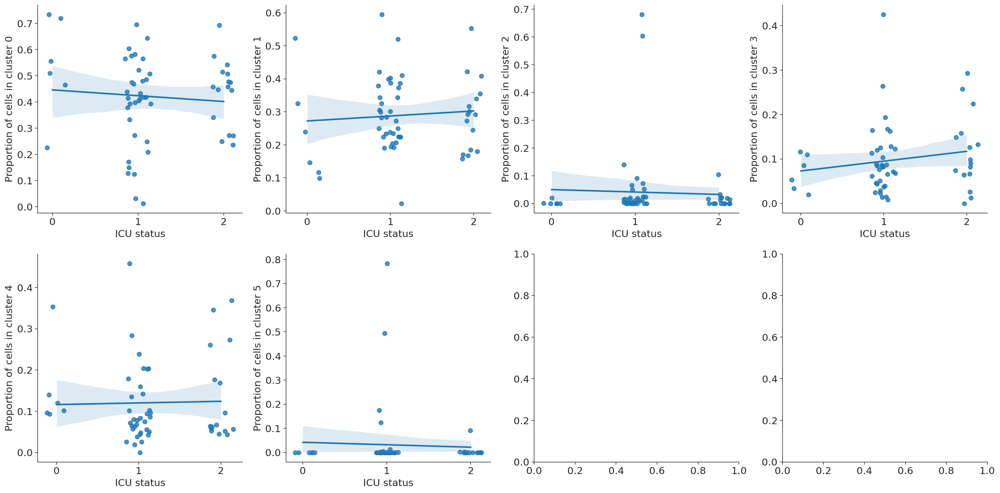

In [22]:
# Plot the top corresponding ones
sns.set_style('white')
sns.set_style('ticks')
f, axes = plt.subplots(2, 4, figsize=(20, 10), sharex=False, sharey=False)
sns.despine()

k = 0
x = adata.obs.groupby('patient').first()['ICU_status'].map({'Healthy': 0, 'Non-ICU': 1, 'ICU': 2}).astype(int)
ya = adata.obs.groupby('patient')['louvain_metab'].value_counts(normalize=True).unstack().fillna(0)

for i in range(2):
    for j in range(4):
        # metabolic cluster ID
        if k > 5:
            break
               
        f = sns.regplot(x=x, y=ya.loc[:, str(k)], x_jitter=0.15, ax=axes[i, j])
        f.set_ylabel('Proportion of cells in cluster ' + str(k))
        f.set_xlabel('ICU status')
        f.set_xticks(range(3))
        k += 1

plt.tight_layout()

In [23]:
# Spearman correlation for ICU status vs. proportion of cells in each metabolic cluster
# Index 0 is r value, index 1 is p-valuee
ya.apply(lambda col: spearmanr(col, x))

louvain_metab,0,1,2,3,4,5
0,-0.064640,0.069765,0.026726,0.163174,-0.075675,0.052273
1,0.635993,0.609404,0.844983,0.229512,0.579357,0.702007


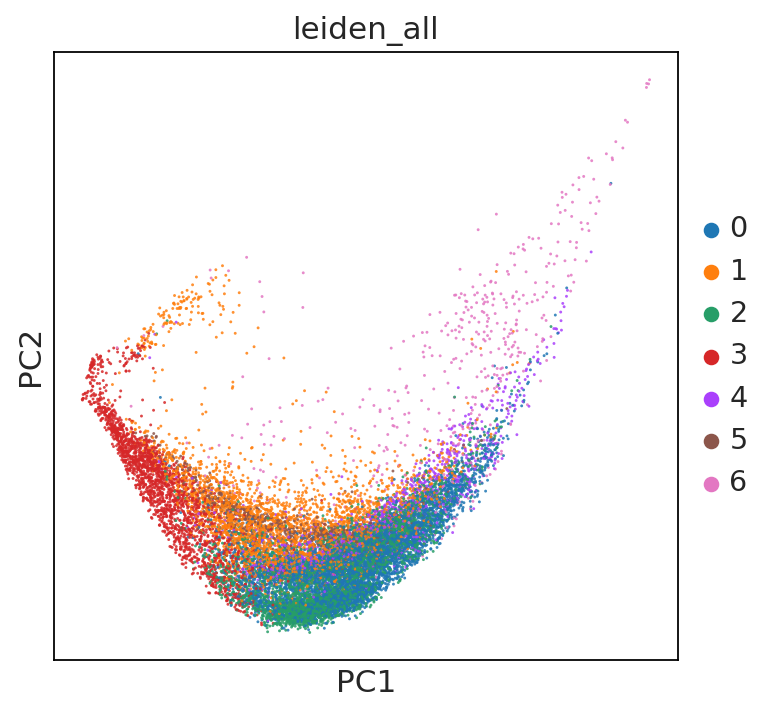

In [24]:
adata_metab.obs['leiden_all'] = adata.obs['leiden']
sc.set_figure_params(figsize=(5, 5))
fig = sc.pl.pca(adata_metab, color='leiden_all', alpha=0.85)#, title='CD4+ cells clustered by all genes')

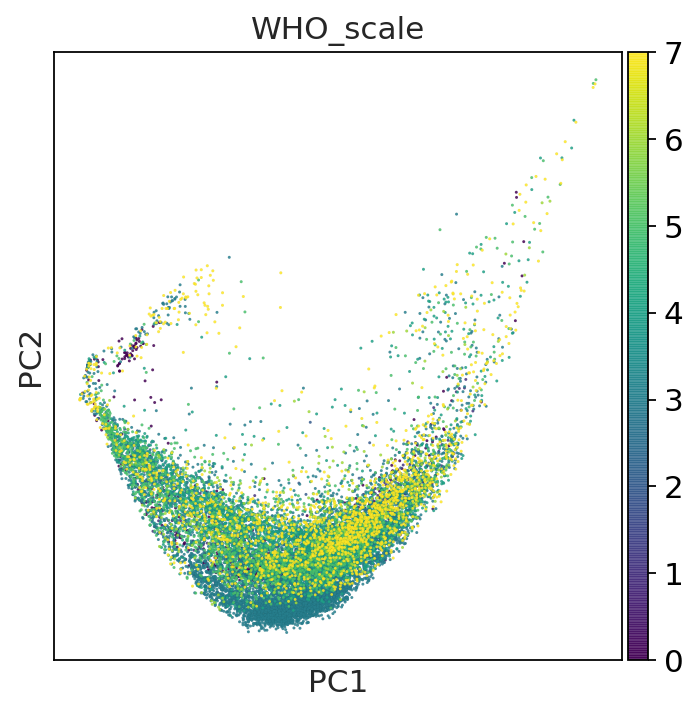

In [25]:
sc.set_figure_params(figsize=(5, 5))
fig = sc.pl.pca(adata_metab, color='WHO_scale', cmap='viridis', linewidth=0.01, edgecolor='black',
               alpha=0.85)#, title='CD4+ cells clustered by all genes')

### Expression of key metabolic regulator genes
7/6/20

In [26]:
spr_corr = ya.apply(lambda col: spearmanr(col, x.values)[0], axis=0)
spr_pvalues = ya.apply(lambda col: spearmanr(col, x.values)[1], axis=0)
spr_corr

louvain_metab
0   -0.064640
1    0.069765
2    0.026726
3    0.163174
4   -0.075675
5    0.052273
dtype: float64

In [27]:
spr_pvalues

louvain_metab
0    0.635993
1    0.609404
2    0.844983
3    0.229512
4    0.579357
5    0.702007
dtype: float64

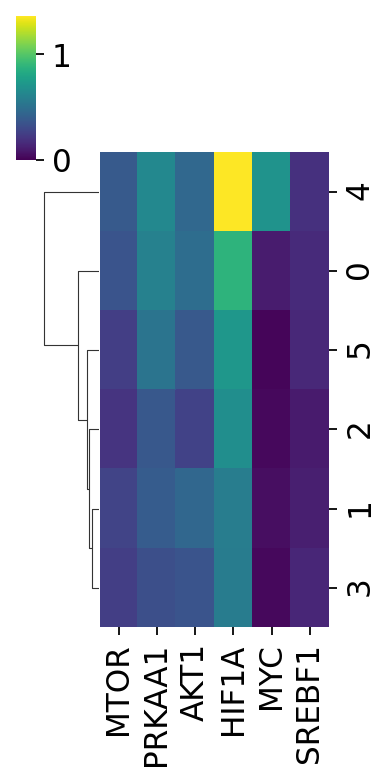

In [23]:
genes = ['MTOR', 'PRKAA1', 'AKT1', 'HIF1A', 'MYC', 'SREBF1']
df = pd.DataFrame(columns=adata.obs['louvain_metab'].unique(), 
                  index=adata.var_names[np.where(adata.var_names.isin(genes))])
for col in df.columns:
    df[col] = np.mean(adata[adata.obs['louvain_metab']==col].X[:, 
              np.where(adata.var_names.isin(genes))], axis=0).flatten()
#df = (df.transpose() / np.sum(df, axis=1)).transpose()
df = pd.merge(pd.DataFrame(genes, index=genes), df, left_index=True, right_index=True)
df = df.drop(columns=0)
sns.clustermap(df.transpose(), col_cluster=False, vmin=0, cmap='viridis', figsize=(2.5, 5))
#sns.heatmap(df)

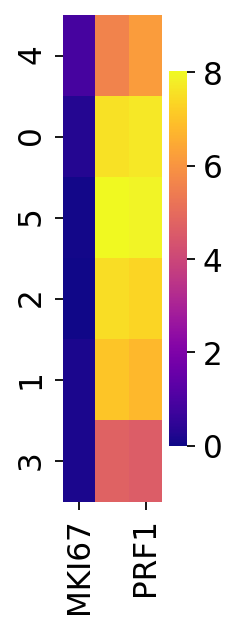

In [26]:
# Now plotting the same as above, but in the order of the metabolic clusters
genes = ['MKI67', 'GZMB', 'PRF1']

df = pd.DataFrame(columns=adata.obs['louvain_metab'].unique(), 
                  index=adata.var_names[np.where(adata.var_names.isin(genes))])
df = df.loc[:, ['3', '1', '2', '5', '0', '4'][::-1]]
for col in df.columns:
    df[col] = np.mean(adata[adata.obs['louvain_metab']==col].X[:, 
              np.where(adata.var_names.isin(genes))], axis=0).flatten()
#df = (df.transpose() / np.sum(df, axis=1)).transpose()
df = pd.merge(pd.DataFrame(genes, index=genes), df, left_index=True, right_index=True)
df = df.drop(columns=0)
fig = plt.figure(figsize=(1, 4))
fig = sns.heatmap(df.transpose(), vmin=0, cmap='plasma')
#sns.heatmap(df)

### Save pseudobulk expression data for each metabolic cluster

In [68]:
# Generate pseudobulk expression data for each metabolic cluster
clusters = list(adata.obs['louvain_metab'].unique())
clusters.sort()
df = pd.DataFrame(columns=clusters, index=adata.var_names)
for cluster in clusters:
    df[cluster] = np.nanmean(adata[adata.obs['louvain_metab']==cluster].X, axis=0)

# Save as a compressed file
# Saving as Excel consumes too much memory
#df.to_csv(master_dir + 'output/' + celltype + '-metab_cluster-pseudobulk.csv.gz', compression='gzip')

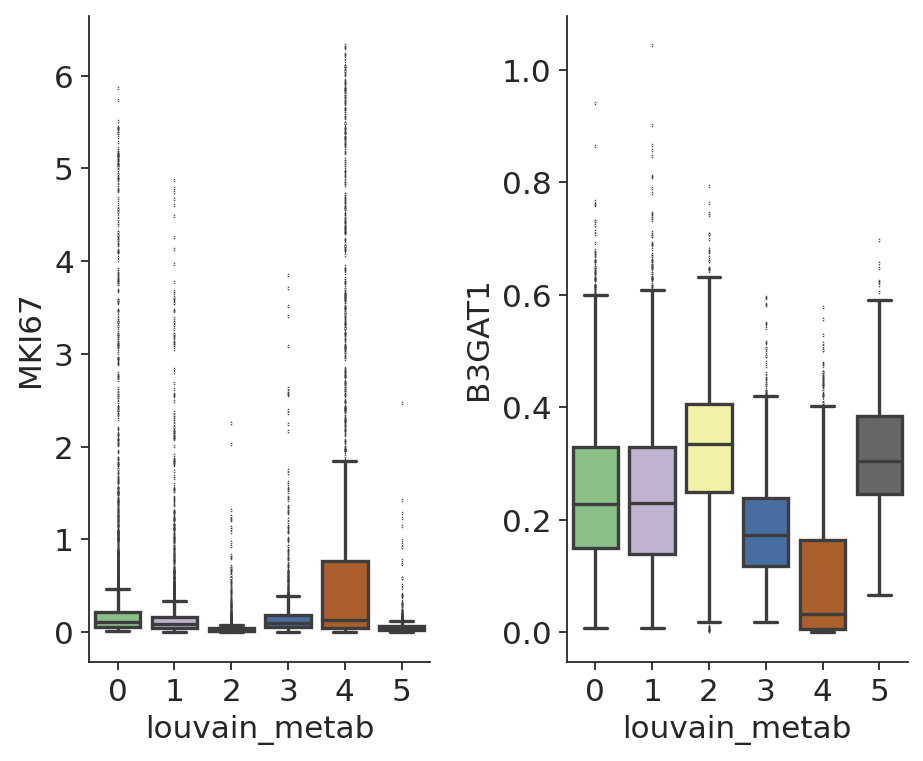

In [31]:
sns.set_style('white')
sns.set_style('ticks')
f, axes = plt.subplots(1, 2, figsize=(6, 5), sharex=True, sharey=False)
sns.despine()

genes = ['MKI67', 'B3GAT1'] #'HIF1A']
k = 0
for i in range(1):
    for j in range(2):
        if k >= len(genes):
            break
        f = sns.boxplot(x=adata.obs['louvain_metab'], y=adata.X[:, adata.var.index.get_loc(genes[k])], 
                        ax=axes[j], palette=adata_metab.uns['louvain_colors'], fliersize=0.01)
        f.set_ylabel(genes[k])
        #f.set_ylim([0, 3])
        k += 1
        #f = plt.errorbar(x=gene_expr_means.index, y=gene_expr_means.iloc[:, i*j],
        #                 xerr=gene_expr_stdev.index, yerr=gene_expr_stdev.iloc[:, i*j], ax=axes[i, j])
f = plt.tight_layout()
plt.savefig(master_dir + 'output/' + celltype + '-key_gene_comparison.pdf')

### Plotting metabolic genes

In [29]:
pathway_name = 'Sphingolipid metabolism'
gene = metab_genes_dict[pathway_name]

# New in revision
adata.obs['severity'] = ['Severe' if x > 4 else 'Moderate' if x > 2 else 'Mild/healthy' 
                         for x in adata.obs['WHO_scale']]

adata_healthy = adata[adata.obs['severity']=='Mild/healthy']
adata_nonICU = adata[adata.obs['severity']=='Moderate']
adata_ICU = adata[adata.obs['severity']=='Severe']

In [30]:
# Compare the single-cell clusters with patient pseodobulk
# All clusters
#f, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True, sharey=True)

#gene = ['LDHA', 'LDHB', 'LDHC']
adata_pseudobulk = adata.copy()
adata_pseudobulk.obs['gene'] = np.mean(adata_pseudobulk.X[:, 
                    np.where(adata.var_names.isin(gene))].reshape([len(adata_pseudobulk), len(gene)]), axis=1)
adata_pseudobulk_obs = adata_pseudobulk.obs.groupby('patient').mean()
adata_pseudobulk_obs = pd.merge(adata_pseudobulk_obs, 
                    adata_pseudobulk.obs.groupby('patient').first().loc[:, ['severity']], on='patient', how='left')

Text(0, 0.5, '')

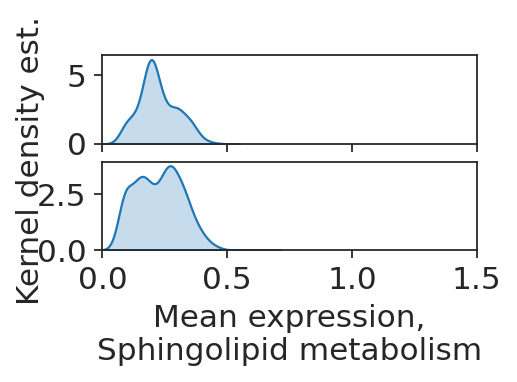

In [31]:
sns.set_style('ticks')
f, axes = plt.subplots(2, 1, figsize=(3, 4*2/5), sharex=True, sharey=False)
f.text(0.0, 0.5, 'Kernel density est.', va='center', rotation='vertical')
f = plt.xlabel('Mean expression,\n' + pathway_name)
f = plt.xlim((0, 1.5))
#f = plt.yticks([0, 2])

bins = np.arange(0, 2.5, 0.01)
bw = 1.25
f = sns.kdeplot(np.mean(adata_healthy.X[np.where(adata_healthy.obs['prolif_noProlif']=='Non-prolif')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['prolif_noProlif']=='Non-prolif'), len(gene)]),
                    axis=1),
                color=adata_metab.uns['prolif_noProlif_colors'][0], shade=True, ax=axes[0], legend=None, bw_adjust=bw)
axes[0].set_ylabel('') 
f = sns.kdeplot(np.mean(adata_ICU.X[np.where(adata_ICU.obs['prolif_noProlif']=='Non-prolif')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['prolif_noProlif']=='Non-prolif'), len(gene)]),
                    axis=1),
                color=adata_metab.uns['prolif_noProlif_colors'][0], shade=True, ax=axes[1], legend=None, bw_adjust=bw)
axes[1].set_ylabel('') 
#plt.savefig(master_dir + 'output/NK-non-prolif-' + pathway_name + '-GEX-by_severity.pdf')

Text(0, 0.5, '')

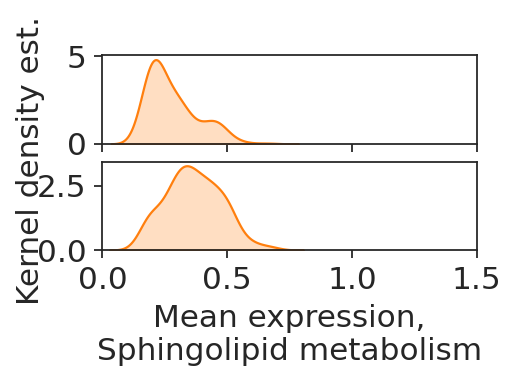

In [32]:
f, axes = plt.subplots(2, 1, figsize=(3, 4*2/5), sharex=True, sharey=False)
f.text(0.0, 0.5, 'Kernel density est.', va='center', rotation='vertical')
f = plt.xlabel('Mean expression,\n' + pathway_name)
f = plt.xlim((0, 1.5))
#f = plt.yticks([0, 2])

bins = np.arange(0, 2.5, 0.01)
bw = 1.25
f = sns.kdeplot(np.mean(adata_healthy.X[np.where(adata_healthy.obs['prolif_noProlif']=='Prolif')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['prolif_noProlif']=='Prolif'), len(gene)]),
                    axis=1),
                color=adata_metab.uns['prolif_noProlif_colors'][1], shade=True, ax=axes[0], legend=None, bw_adjust=bw)
axes[0].set_ylabel('') 
f = sns.kdeplot(np.mean(adata_ICU.X[np.where(adata_ICU.obs['prolif_noProlif']=='Prolif')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['prolif_noProlif']=='Prolif'), len(gene)]),
                    axis=1),
                color=adata_metab.uns['prolif_noProlif_colors'][1], shade=True, ax=axes[1], legend=None, bw_adjust=bw)
axes[1].set_ylabel('') 
#plt.savefig(master_dir + 'output/NK-prolif-' + pathway_name + '-GEX-by_severity.pdf')

In [33]:
mannwhitneyu(np.mean(adata_healthy.X[np.where(adata_healthy.obs['prolif_noProlif']=='Prolif')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_healthy.obs['prolif_noProlif']=='Prolif'), len(gene)]),
                    axis=1),
            np.mean(adata_ICU.X[np.where(adata_ICU.obs['prolif_noProlif']=='Prolif')][:, 
                    np.where(adata.var_names.isin(gene))].reshape([sum(adata_ICU.obs['prolif_noProlif']=='Prolif'), len(gene)]),
                    axis=1))

MannwhitneyuResult(statistic=41693.0, pvalue=6.846871157350568e-25)

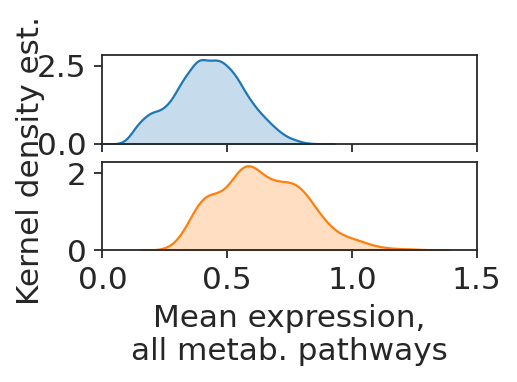

In [38]:
f, axes = plt.subplots(2, 1, figsize=(3, 4*2/5), sharex=True, sharey=False)
f.text(0.0, 0.5, 'Kernel density est.', va='center', rotation='vertical')
#f = plt.xlabel('Mean expression, ' + pathway_name)
f = plt.xlabel('Mean expression,\nall metab. pathways')
f = plt.xlim((0, 1.5))
#f = plt.yticks([0, 2])

bins = np.arange(0, 2.5, 0.01)
bw = 1.25
f = sns.kdeplot(np.mean(adata.X[np.where(adata.obs['prolif_noProlif']=='Non-prolif')][:, 
                    np.where(adata.var_names.isin(adata_metab.var_names))].reshape([sum(adata.obs['prolif_noProlif']=='Non-prolif'), len(adata_metab.var_names)]),
                    axis=1),
                color=adata_metab.uns['prolif_noProlif_colors'][0], shade=True, ax=axes[0], legend=None, bw_adjust=bw)
axes[0].set_ylabel('') 
f = sns.kdeplot(np.mean(adata.X[np.where(adata.obs['prolif_noProlif']=='Prolif')][:, 
                    np.where(adata.var_names.isin(adata_metab.var_names))].reshape([sum(adata.obs['prolif_noProlif']=='Prolif'), len(adata_metab.var_names)]),
                    axis=1),
                color=adata_metab.uns['prolif_noProlif_colors'][1], shade=True, ax=axes[1], legend=None, bw_adjust=bw)
axes[1].set_ylabel('') 

#plt.savefig(master_dir + 'output/NK-all-All_pathways-GEX-by_severity.pdf')

In [28]:
mannwhitneyu(np.mean(adata.X[np.where(adata.obs['prolif_noProlif']=='Non-prolif')][:, 
                    np.where(adata.var_names.isin(adata_metab.var_names))].reshape([sum(adata.obs['prolif_noProlif']=='Non-prolif'), len(adata_metab.var_names)]),
                    axis=1),
            np.mean(adata.X[np.where(adata.obs['prolif_noProlif']=='Prolif')][:, 
                    np.where(adata.var_names.isin(adata_metab.var_names))].reshape([sum(adata.obs['prolif_noProlif']=='Prolif'), len(adata_metab.var_names)]),
                    axis=1))

MannwhitneyuResult(statistic=4418198.0, pvalue=0.0)